In [1]:
# %pip install umap-learn[plot]
# %pip install sklearn --upgrade
# %pip install ipywidgets

In [2]:
import numpy as np
import umap
import umap.plot
import quick_torch as qt
import matplotlib.pyplot as plt
import sklearn.neighbors
plt.rcParams["figure.figsize"] = 15, 15
%matplotlib inline

# Dimension reduction and clustering libraries
import umap
import sklearn.cluster as cluster

/home/fmunoz/codeProjects/pythonProjects/quick-torch/.venv/lib/python3.10/site-packages/umap/plot.py:203: NumbaDeprecationWarning: The keyword argument 'nopython=False' was supplied. From Numba 0.59.0 the default is being changed to True and use of 'nopython=False' will raise a warning as the argument will have no effect. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit(nopython=False)


In [3]:
def plot_images(data, n_cols=10, n_rows=10, figsize=(10,10), n_plots=3):
    n_data = len(data)
    n_img = n_cols * n_rows
    assert n_data >= n_img, f"Number of images is less than {n_img}"

    n_plots = min(n_plots, n_data // n_img) if n_plots is not None else n_data // n_img
    
    init_range, final_range = 0, n_img
    for i in range(n_plots):
        _, axes = plt.subplots(n_rows, n_cols, figsize=figsize)
        for i, ax in enumerate(axes.flatten()):
            ax.imshow(data[init_range:final_range][i].reshape((28,28)))
            plt.setp(ax, xticks=[], yticks=[])
        plt.tight_layout()
        plt.show()
        init_range += n_img
        final_range += n_img

# Smiley Faces

In [4]:
dataset_smiley_face = qt.QuickDraw("dataset", [qt.Category.SMILEY_FACE], download=True)
data = dataset_smiley_face.data.reshape(-1, 784)
data.shape

(124386, 784)

## Outliers

In [5]:
mapper = umap.UMAP(set_op_mix_ratio=0.25, verbose=True).fit(data)

UMAP(set_op_mix_ratio=0.25, verbose=True)
Fri Oct  6 22:23:16 2023 Construct fuzzy simplicial set


/home/fmunoz/codeProjects/pythonProjects/quick-torch/.venv/lib/python3.10/site-packages/numba/np/ufunc/parallel.py:371: NumbaWarning: The TBB threading layer requires TBB version 2021 update 6 or later i.e., TBB_INTERFACE_VERSION >= 12060. Found TBB_INTERFACE_VERSION = 12050. The TBB threading layer is disabled.
  warnings.warn(problem)


Fri Oct  6 22:23:17 2023 Finding Nearest Neighbors
Fri Oct  6 22:23:17 2023 Building RP forest with 23 trees
Fri Oct  6 22:23:28 2023 NN descent for 17 iterations
	 1  /  17
	 2  /  17
	 3  /  17
	 4  /  17
	 5  /  17
	Stopping threshold met -- exiting after 5 iterations
Fri Oct  6 22:23:49 2023 Finished Nearest Neighbor Search
Fri Oct  6 22:23:52 2023 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Fri Oct  6 22:24:18 2023 Finished embedding


<Axes: >

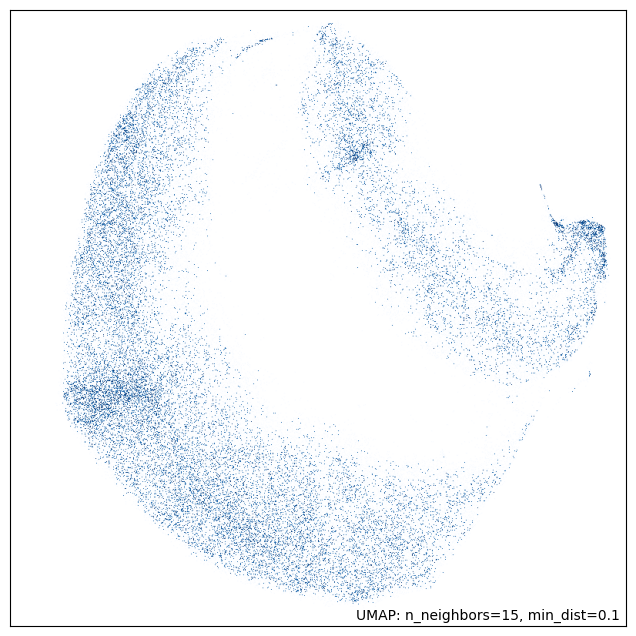

In [6]:
umap.plot.points(mapper)

In [7]:
outlier_scores = sklearn.neighbors.LocalOutlierFactor().fit_predict(mapper.embedding_)

In [8]:
sum(outlier_scores == -1)

286

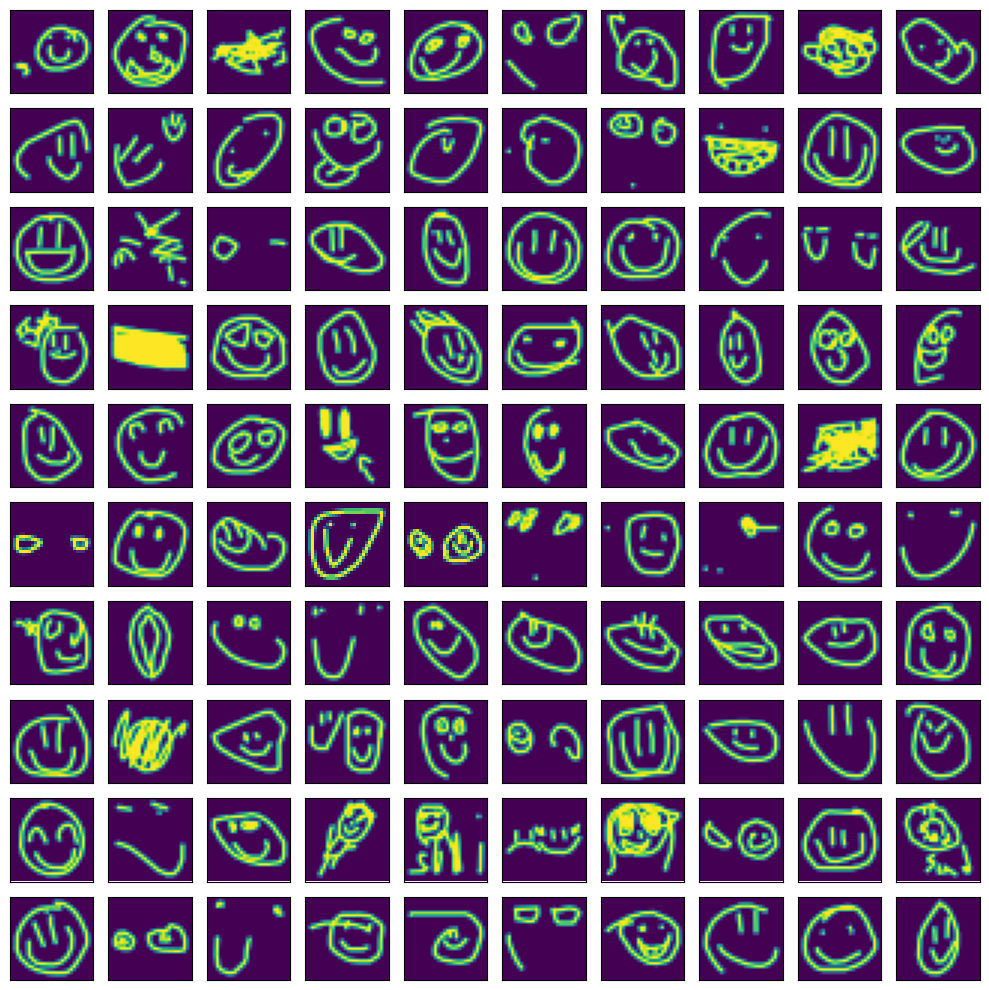

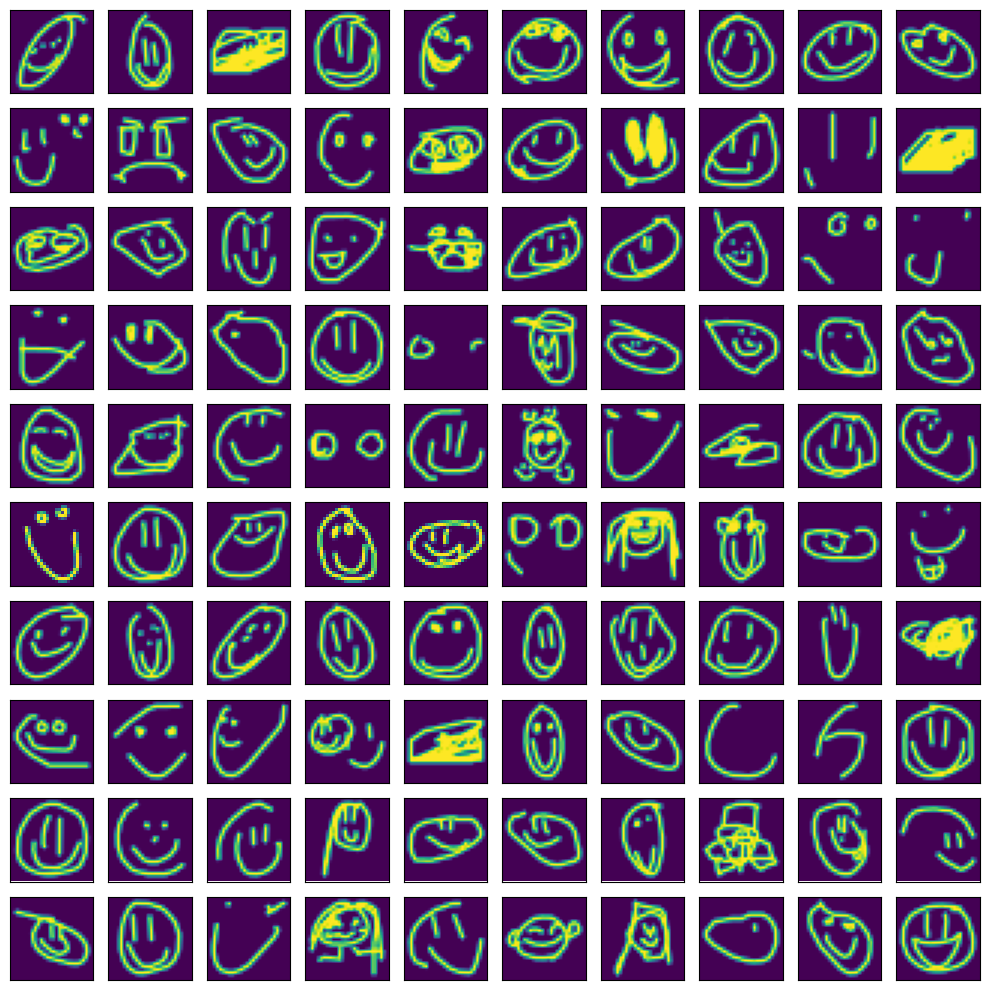

In [9]:
plot_images(data[outlier_scores == -1], 10, 10)

In [10]:
data =  data[outlier_scores != -1]
data.shape

(124100, 784)

In [11]:
del mapper, outlier_scores

## Clusters

In [12]:
mapper = umap.UMAP(
    n_neighbors=30,
    min_dist=0.0,
    set_op_mix_ratio=1, 
    verbose=True,
).fit(data)

UMAP(min_dist=0.0, n_neighbors=30, set_op_mix_ratio=1, verbose=True)
Fri Oct  6 22:24:30 2023 Construct fuzzy simplicial set
Fri Oct  6 22:24:31 2023 Finding Nearest Neighbors
Fri Oct  6 22:24:31 2023 Building RP forest with 23 trees
Fri Oct  6 22:24:36 2023 NN descent for 17 iterations
	 1  /  17
	 2  /  17
	 3  /  17
	 4  /  17
	Stopping threshold met -- exiting after 4 iterations
Fri Oct  6 22:24:51 2023 Finished Nearest Neighbor Search
Fri Oct  6 22:24:52 2023 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Fri Oct  6 22:25:48 2023 Finished embedding


<Axes: >

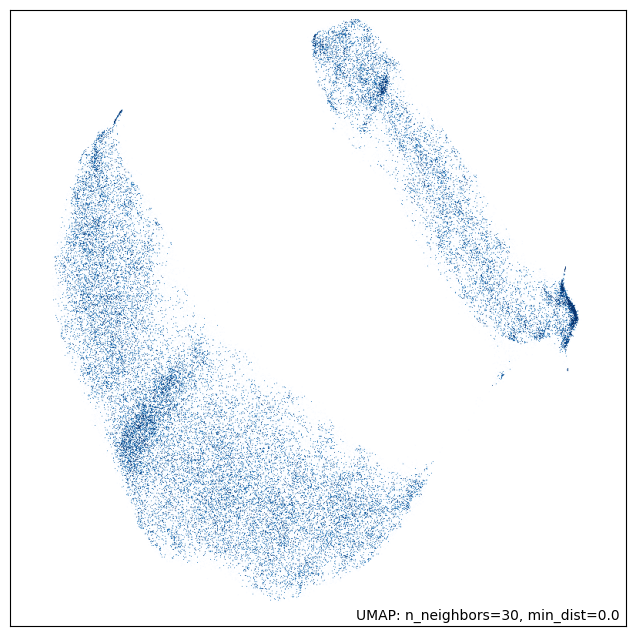

In [13]:
umap.plot.points(mapper)

In [14]:
clusterable_embedding = mapper.embedding_

In [24]:
labels = cluster.DBSCAN(min_samples=500).fit_predict(clusterable_embedding)

<Axes: >

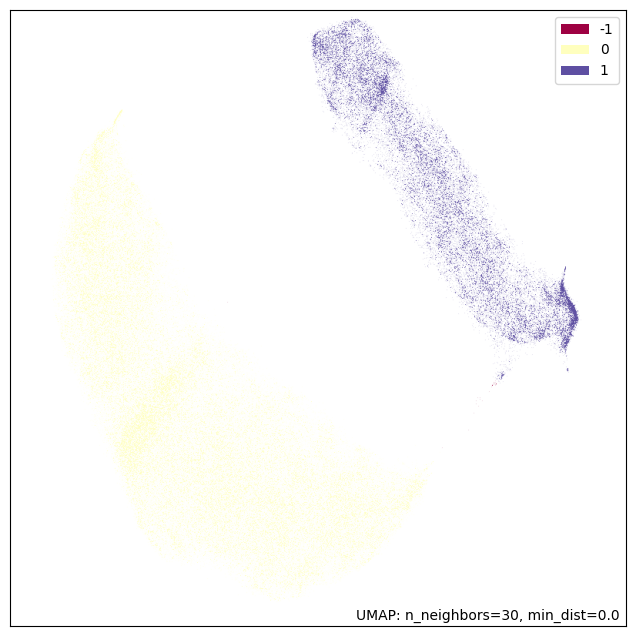

In [25]:
umap.plot.points(mapper, labels=labels)

In [26]:
np.unique(labels)

array([-1,  0,  1])

In [27]:
sum(labels == -1)

29

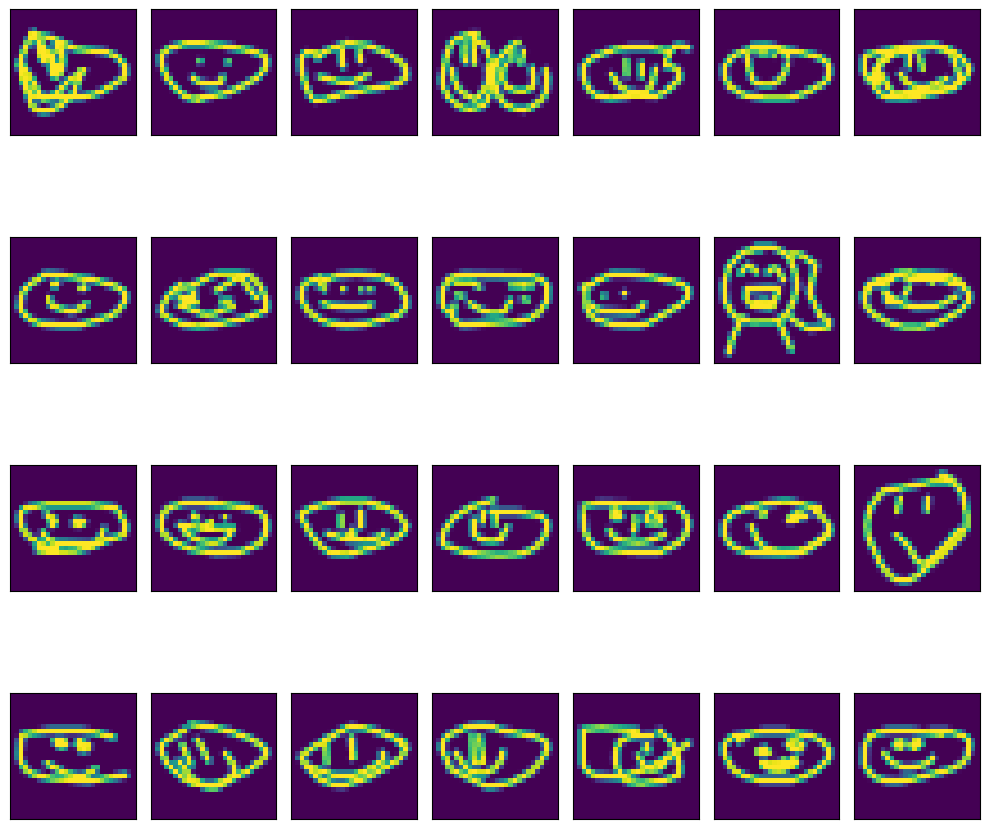

In [30]:
plot_images(data[labels == -1], 7, 4, n_plots=1)

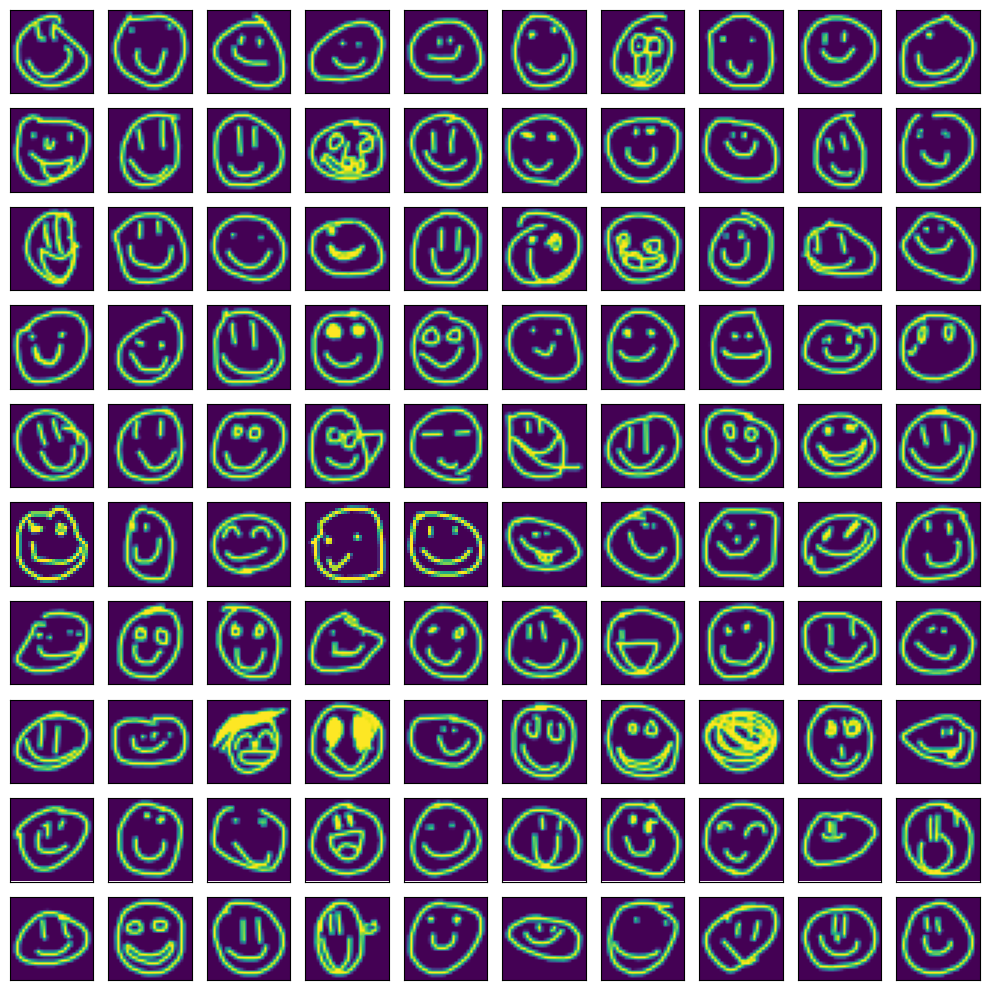

In [28]:
plot_images(data[labels == 0], 10, 10, n_plots=1)

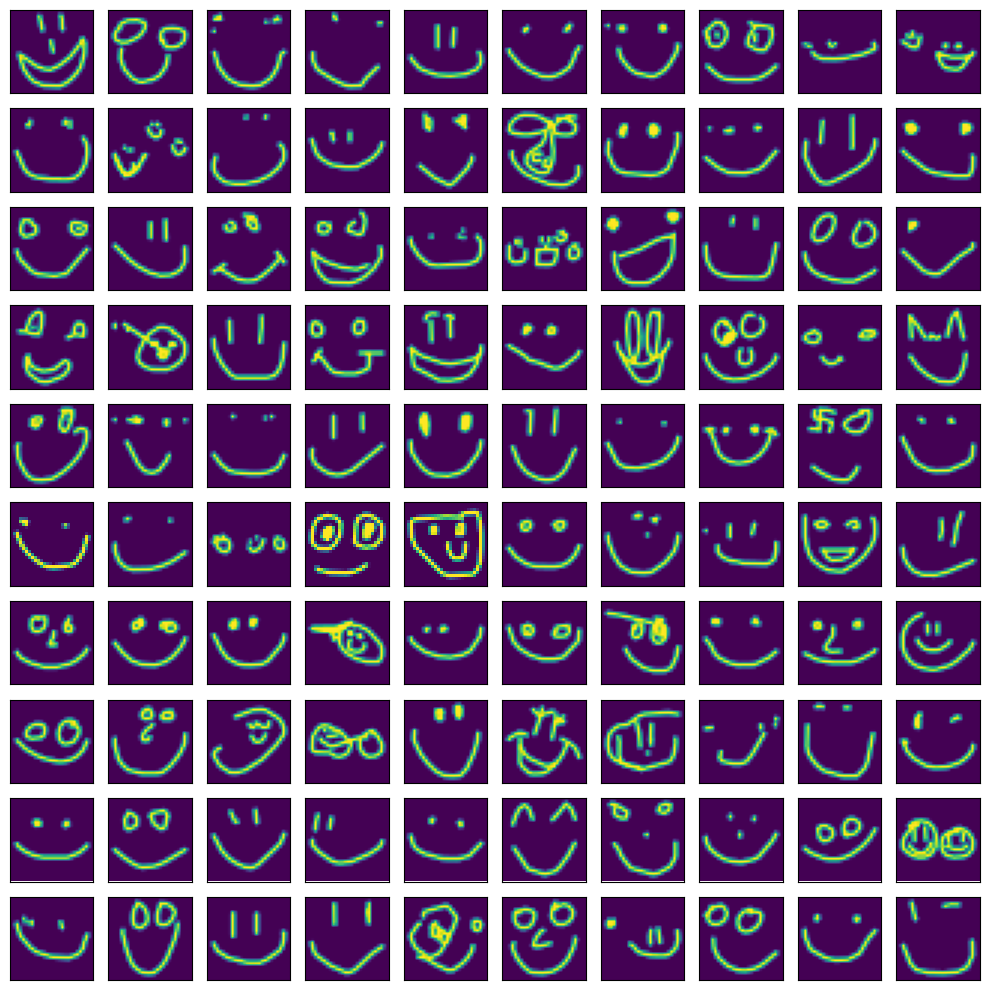

In [29]:
plot_images(data[labels == 1], 10, 10, n_plots=1)

In [31]:
data = data[labels == 0]
len(data)

91044

In [32]:
del mapper, clusterable_embedding, labels

## Outliers, again

In [33]:
mapper = umap.UMAP(
    set_op_mix_ratio=0.25,
    verbose=True,
).fit(data)

UMAP(set_op_mix_ratio=0.25, verbose=True)
Fri Oct  6 22:31:46 2023 Construct fuzzy simplicial set
Fri Oct  6 22:31:46 2023 Finding Nearest Neighbors
Fri Oct  6 22:31:46 2023 Building RP forest with 20 trees
Fri Oct  6 22:31:50 2023 NN descent for 16 iterations
	 1  /  16
	 2  /  16
	 3  /  16
	 4  /  16
	 5  /  16
	Stopping threshold met -- exiting after 5 iterations
Fri Oct  6 22:31:56 2023 Finished Nearest Neighbor Search
Fri Oct  6 22:31:57 2023 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Fri Oct  6 22:32:17 2023 Finished embedding


<Axes: >

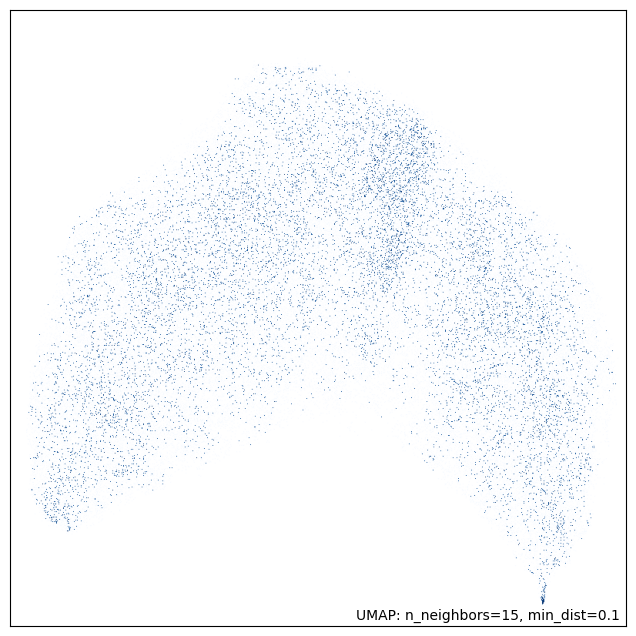

In [34]:
umap.plot.points(mapper)

In [36]:
outlier_scores = sklearn.neighbors.LocalOutlierFactor().fit_predict(mapper.embedding_)

In [37]:
np.unique(outlier_scores)

array([-1,  1])

In [38]:
sum(outlier_scores == -1)

72

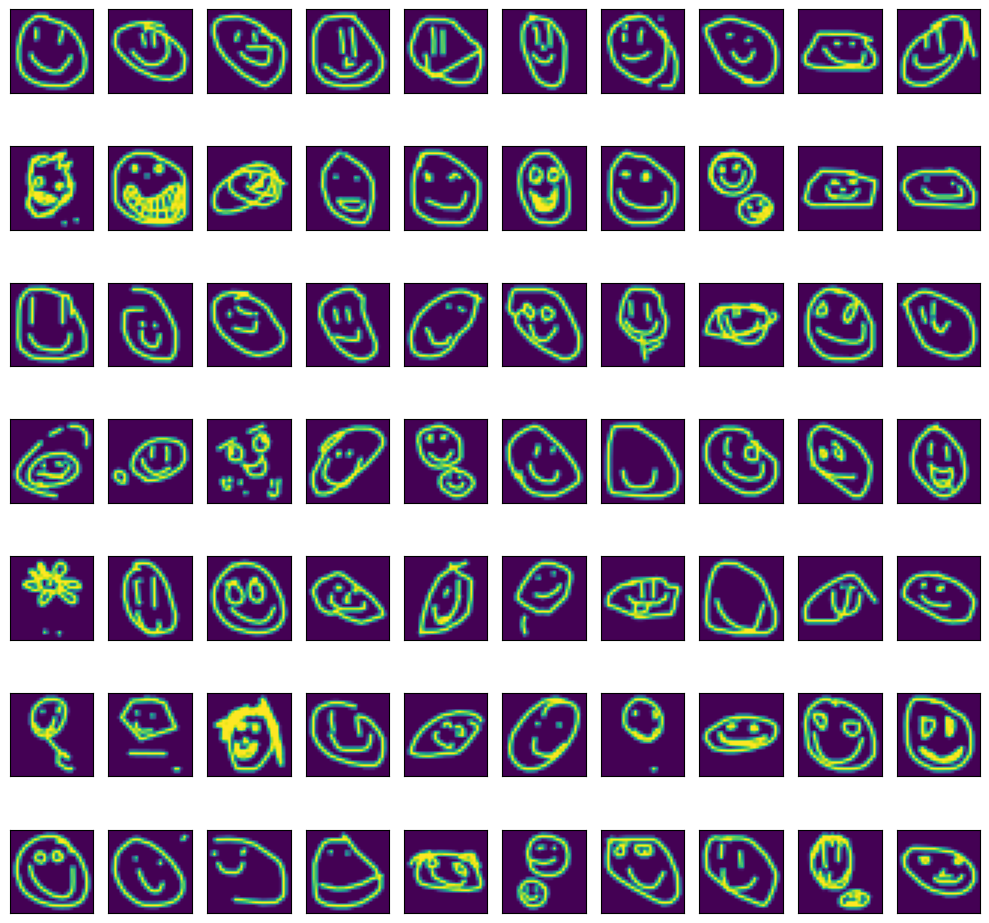

In [39]:
plot_images(data[outlier_scores == -1], 10, 7, n_plots=1)

In [40]:
data = data[outlier_scores != -1]

In [41]:
del mapper, outlier_scores

In [42]:
dataset_smiley_face.data = data.reshape(-1, 28, 28)
dataset_smiley_face.targets = dataset_smiley_face.targets[:len(data)]
len(dataset_smiley_face)

90972

# Faces

In [43]:
dataset_face = qt.QuickDraw("dataset", [qt.Category.FACE], download=True)
data = dataset_face.data.reshape(-1, 784)
data.shape

(161666, 784)

## Outliers

In [44]:
mapper = umap.UMAP(set_op_mix_ratio=0.25, verbose=True).fit(data)

UMAP(set_op_mix_ratio=0.25, verbose=True)
Fri Oct  6 22:33:40 2023 Construct fuzzy simplicial set
Fri Oct  6 22:33:40 2023 Finding Nearest Neighbors
Fri Oct  6 22:33:40 2023 Building RP forest with 25 trees
Fri Oct  6 22:33:50 2023 NN descent for 17 iterations
	 1  /  17
	 2  /  17
	 3  /  17
	 4  /  17
	 5  /  17
	 6  /  17
	Stopping threshold met -- exiting after 6 iterations
Fri Oct  6 22:34:01 2023 Finished Nearest Neighbor Search
Fri Oct  6 22:34:02 2023 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Fri Oct  6 22:34:39 2023 Finished embedding


<Axes: >

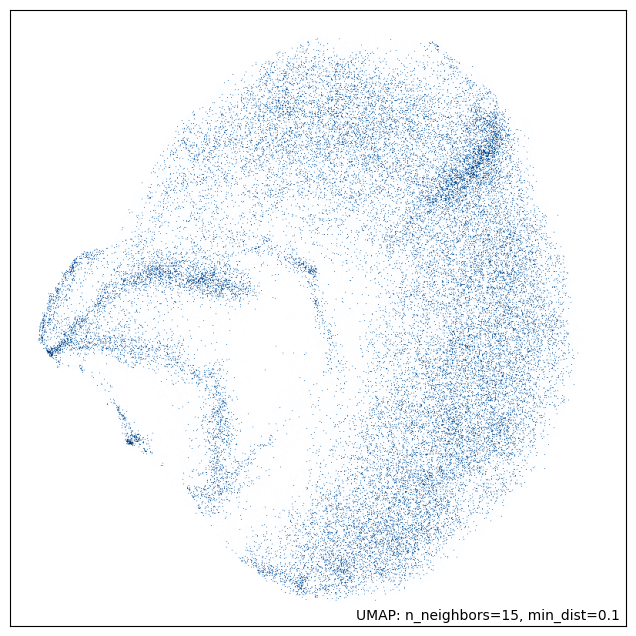

In [45]:
umap.plot.points(mapper)

In [46]:
outlier_scores = sklearn.neighbors.LocalOutlierFactor().fit_predict(mapper.embedding_)

In [47]:
sum(outlier_scores == -1)

166

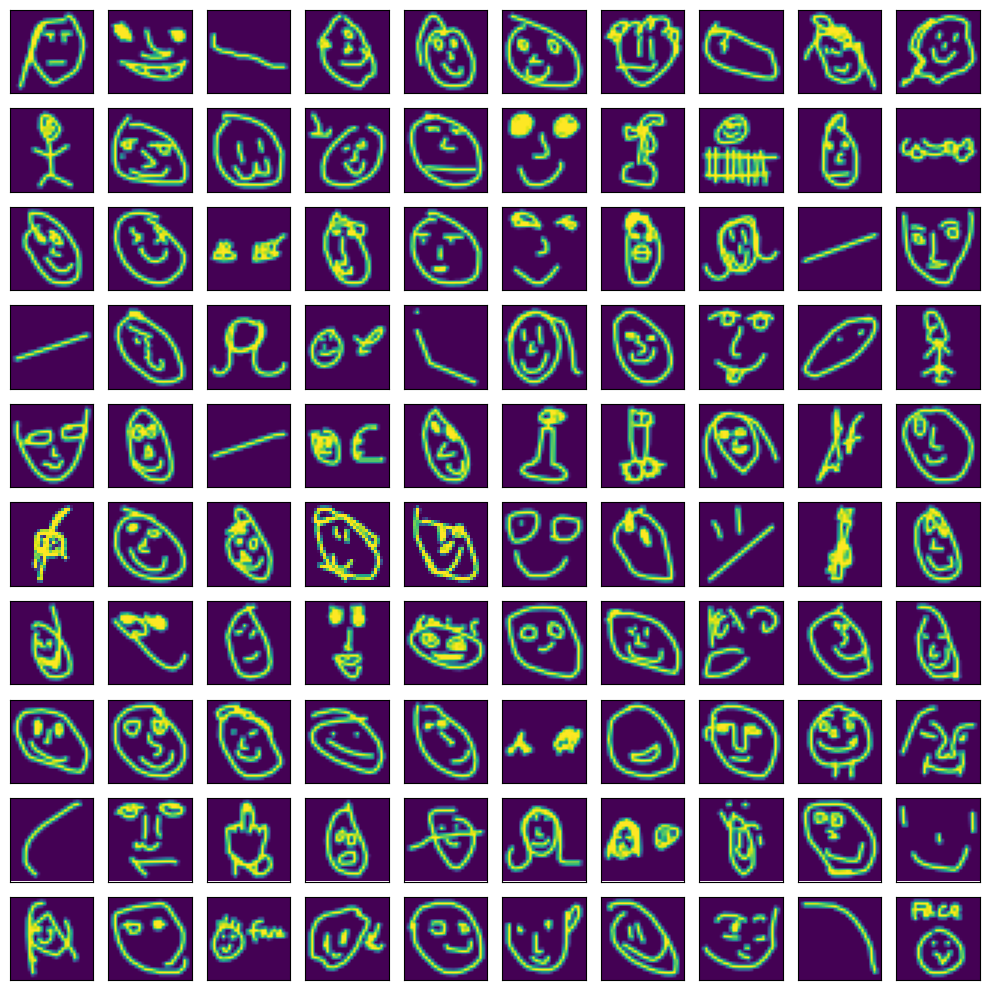

In [48]:
plot_images(data[outlier_scores == -1], 10, 10)

In [49]:
data = data[outlier_scores != -1]
data.shape

(161500, 784)

In [50]:
del mapper, outlier_scores

## Clustering

In [51]:
mapper = umap.UMAP(
    n_neighbors=30,
    min_dist=0.0,
    verbose=True,
    n_epochs=500,
).fit(data)

UMAP(min_dist=0.0, n_epochs=500, n_neighbors=30, set_op_mix_ratio=1, verbose=True)
Fri Oct  6 22:35:14 2023 Construct fuzzy simplicial set
Fri Oct  6 22:35:15 2023 Finding Nearest Neighbors
Fri Oct  6 22:35:15 2023 Building RP forest with 25 trees
Fri Oct  6 22:35:22 2023 NN descent for 17 iterations
	 1  /  17
	 2  /  17
	 3  /  17
	 4  /  17
	 5  /  17
	Stopping threshold met -- exiting after 5 iterations
Fri Oct  6 22:35:44 2023 Finished Nearest Neighbor Search
Fri Oct  6 22:35:46 2023 Construct embedding


Epochs completed:   0%|            0/500 [00:00]

	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
Fri Oct  6 22:38:17 2023 Finished embedding


<Axes: >

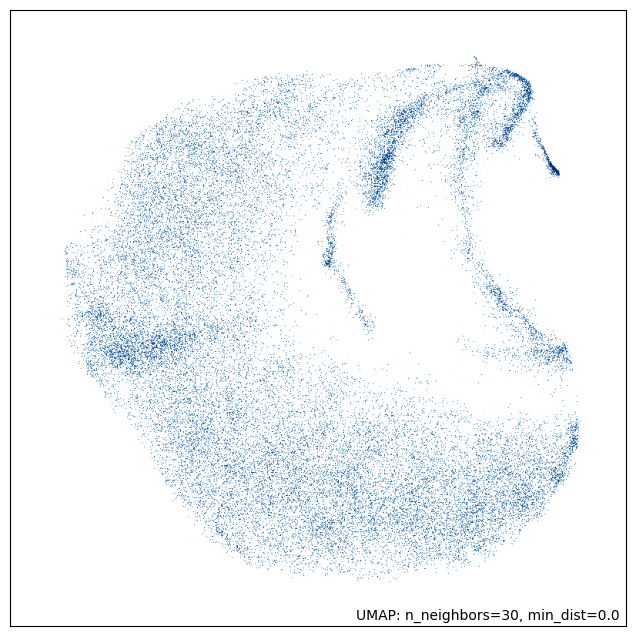

In [52]:
umap.plot.points(mapper)

In [53]:
clusterable_embedding = mapper.embedding_

In [54]:
labels = cluster.HDBSCAN(min_cluster_size=100).fit_predict(clusterable_embedding)

In [55]:
np.unique(labels)

array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8])

In [56]:
sum(labels == -1), sum(labels != -1)

(16600, 144900)

In [57]:
for i in np.unique(labels):
    print(f"Cluster {i}: {sum(labels == i)}")

Cluster -1: 16600
Cluster 0: 123829
Cluster 1: 1281
Cluster 2: 481
Cluster 3: 1274
Cluster 4: 139
Cluster 5: 14126
Cluster 6: 128
Cluster 7: 241
Cluster 8: 3401


<Axes: >

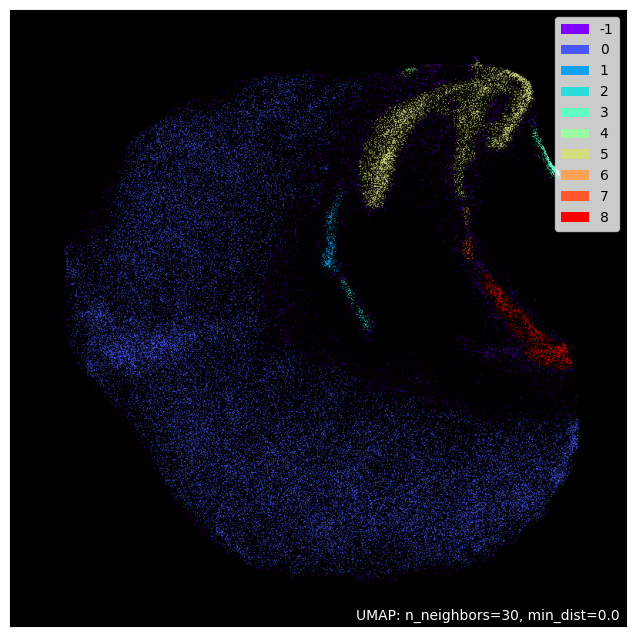

In [58]:
umap.plot.points(mapper, labels=labels, theme="fire")

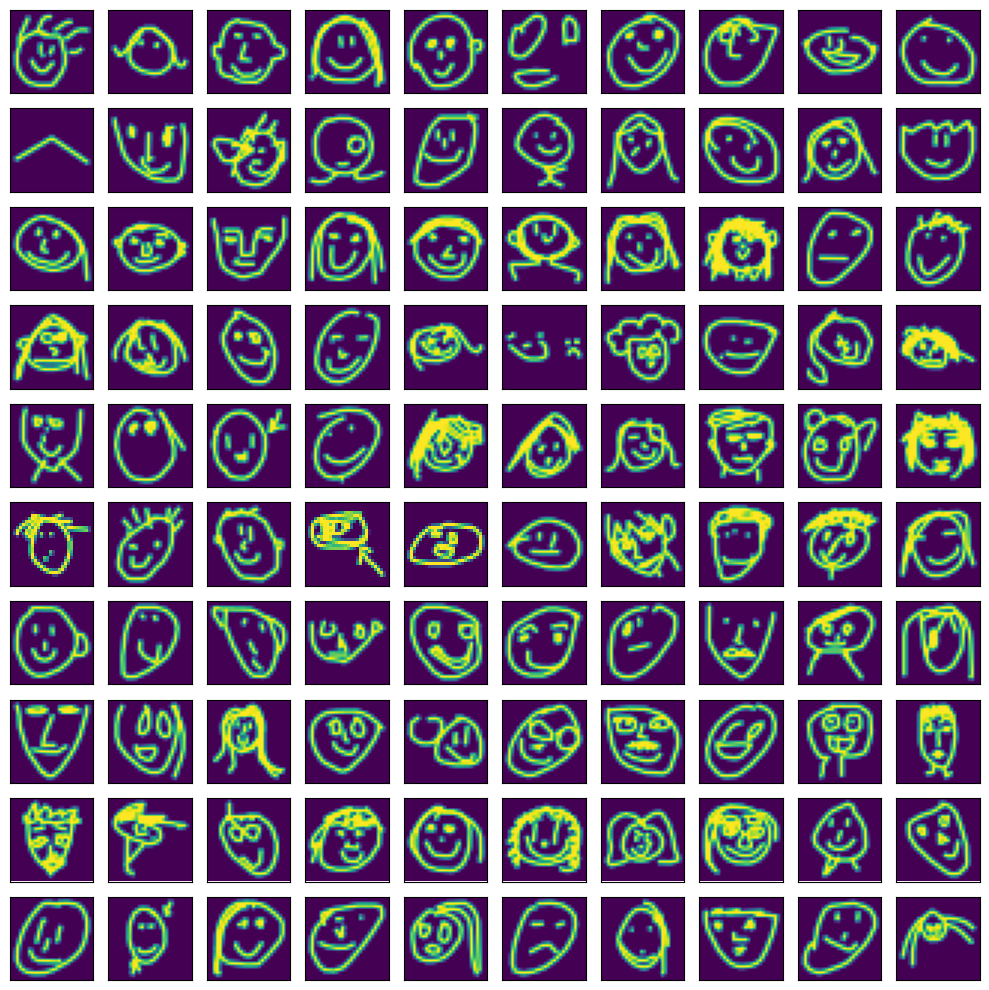

In [59]:
plot_images(data[labels == -1], 10, 10, n_plots=1)

In [60]:
labels_to_keep = labels == -1
sum(labels_to_keep)

16600

Cluster 0: 123829


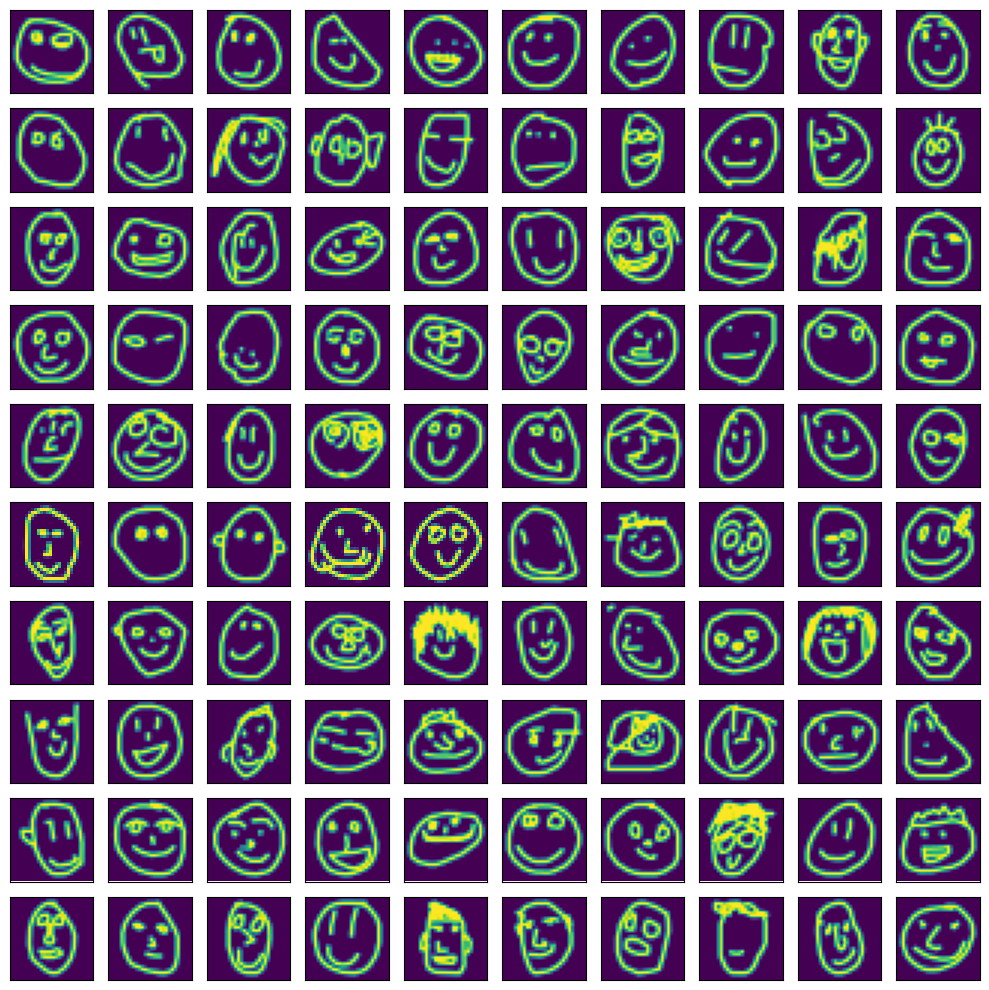

In [61]:
label = 0
print(f"Cluster {label}: {sum(labels == label)}")
plot_images(data[labels == label], 10, 10, n_plots=1)

In [62]:
labels_to_keep = np.logical_or(labels_to_keep, labels == label)
sum(labels_to_keep)

140429

Cluster 1: 1281


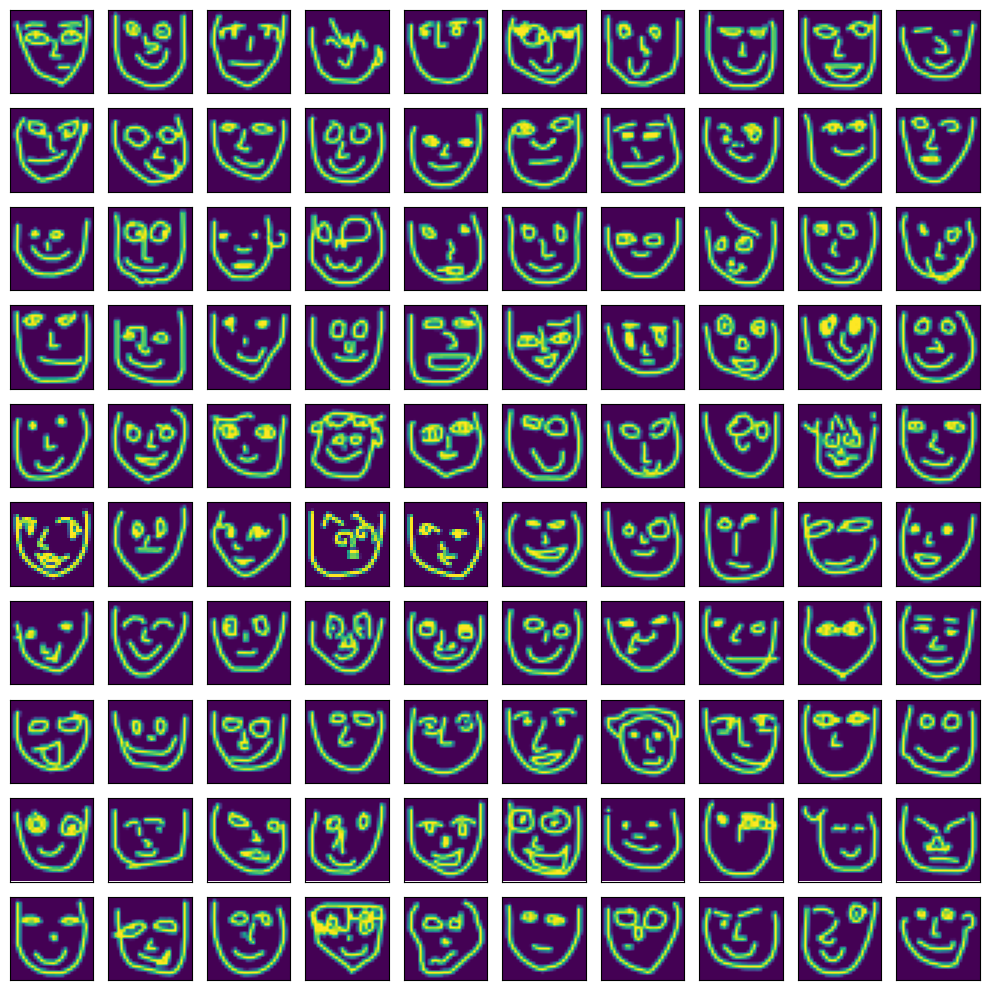

In [63]:
label = 1
print(f"Cluster {label}: {sum(labels == label)}")
plot_images(data[labels == label], 10, 10, n_plots=1)

In [ ]:
# labels_to_keep = np.logical_or(labels_to_keep, labels == label)
# sum(labels_to_keep)

Cluster 2: 481


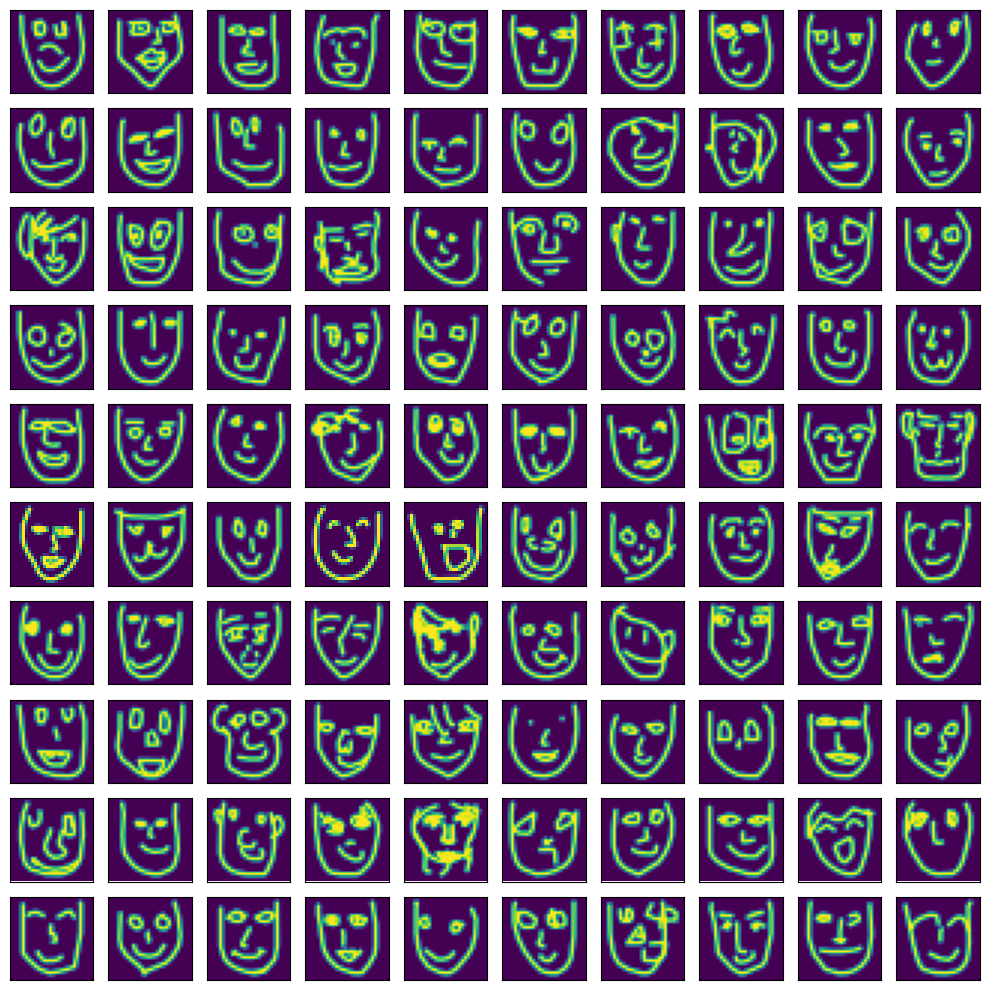

In [64]:
label = 2
print(f"Cluster {label}: {sum(labels == label)}")
plot_images(data[labels == label], 10, 10, n_plots=1)

In [ ]:
# labels_to_keep = np.logical_or(labels_to_keep, labels == label)
# sum(labels_to_keep)

Cluster 3: 1274


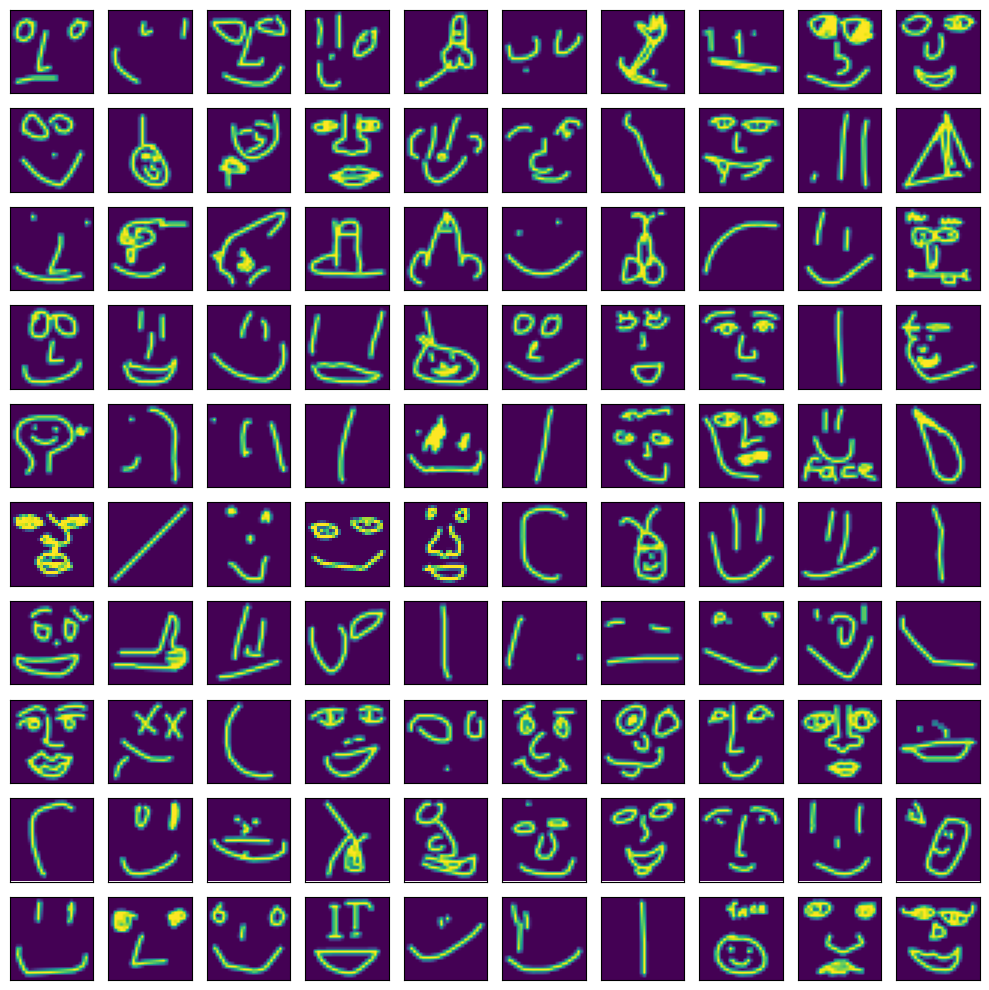

In [65]:
label = 3
print(f"Cluster {label}: {sum(labels == label)}")
plot_images(data[labels == label], 10, 10, n_plots=1)

In [ ]:
# labels_to_keep = np.logical_or(labels_to_keep, labels == label)
# sum(labels_to_keep)

Cluster 4: 139


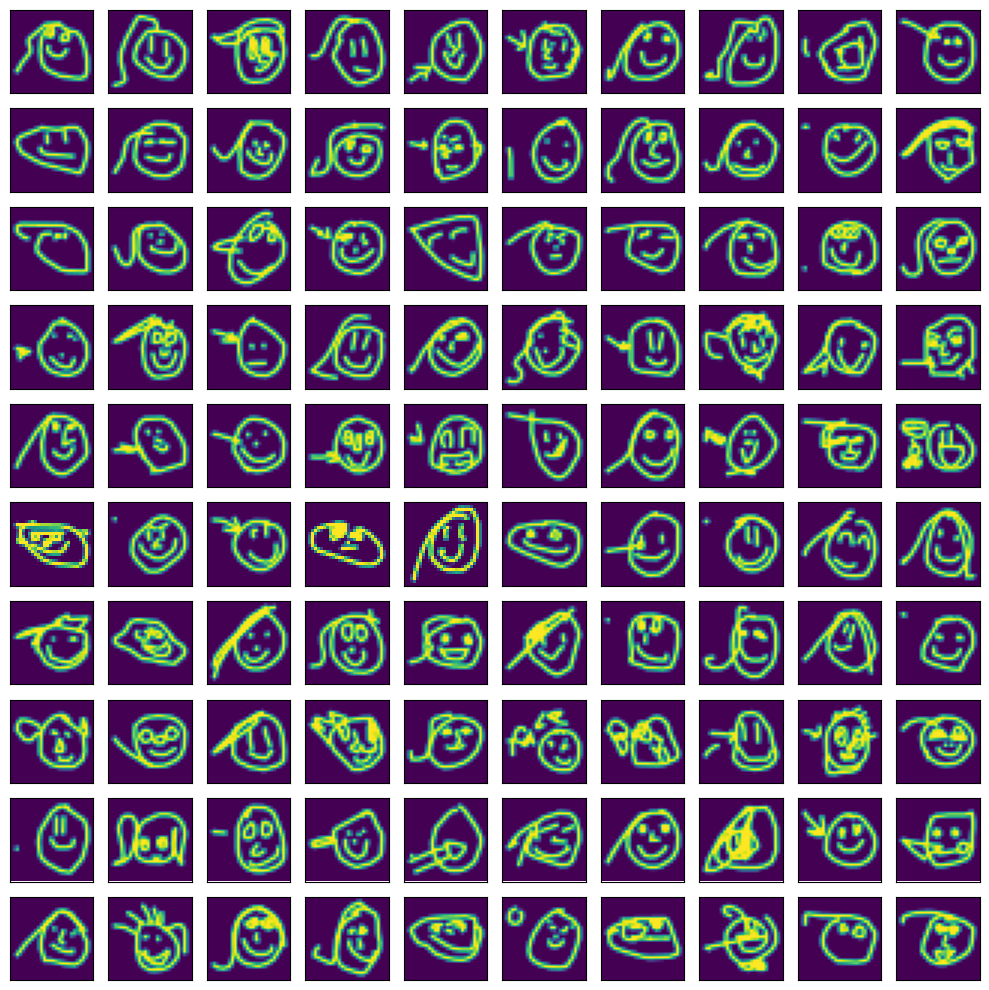

In [66]:
label = 4
print(f"Cluster {label}: {sum(labels == label)}")
plot_images(data[labels == label], 10, 10, n_plots=1)

In [ ]:
# labels_to_keep = np.logical_or(labels_to_keep, labels == label)
# sum(labels_to_keep)

Cluster 5: 14126


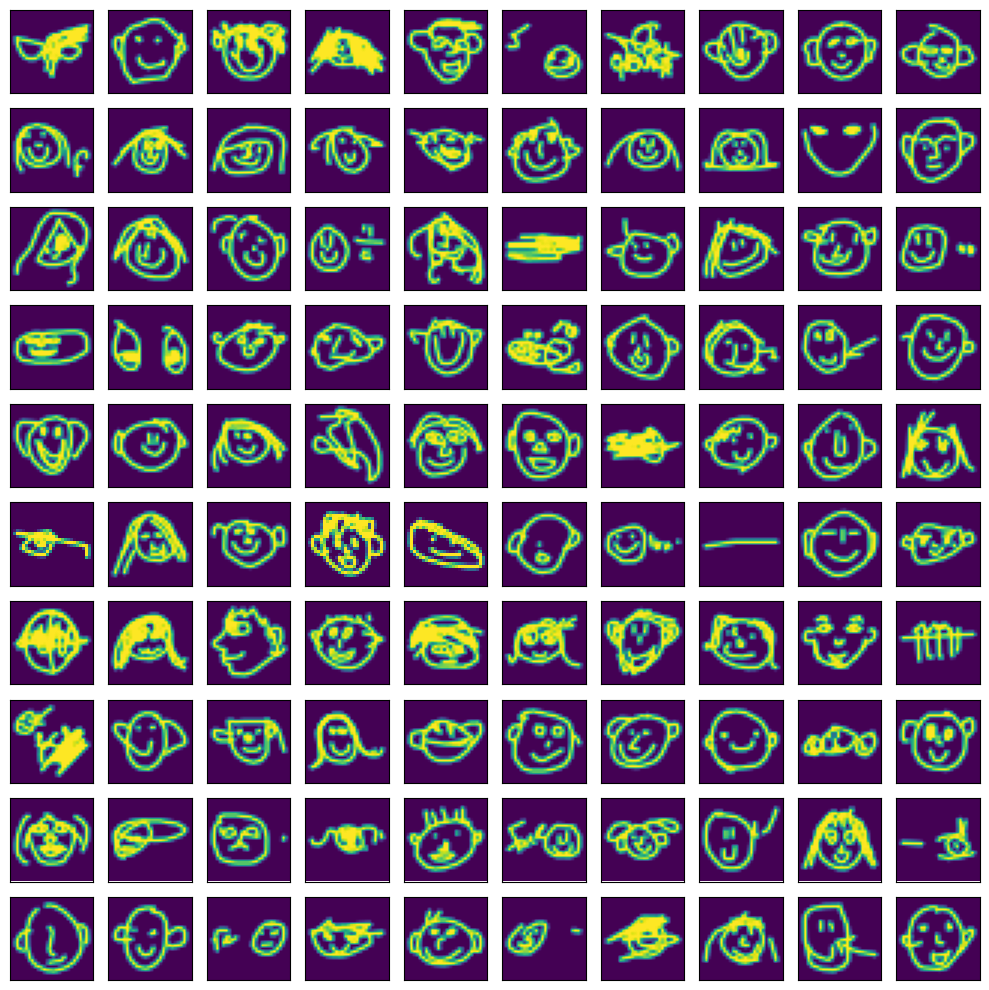

In [67]:
label = 5
print(f"Cluster {label}: {sum(labels == label)}")
plot_images(data[labels == label], 10, 10, n_plots=1)

In [ ]:
# labels_to_keep = np.logical_or(labels_to_keep, labels == label)
# sum(labels_to_keep)

Cluster 6: 128


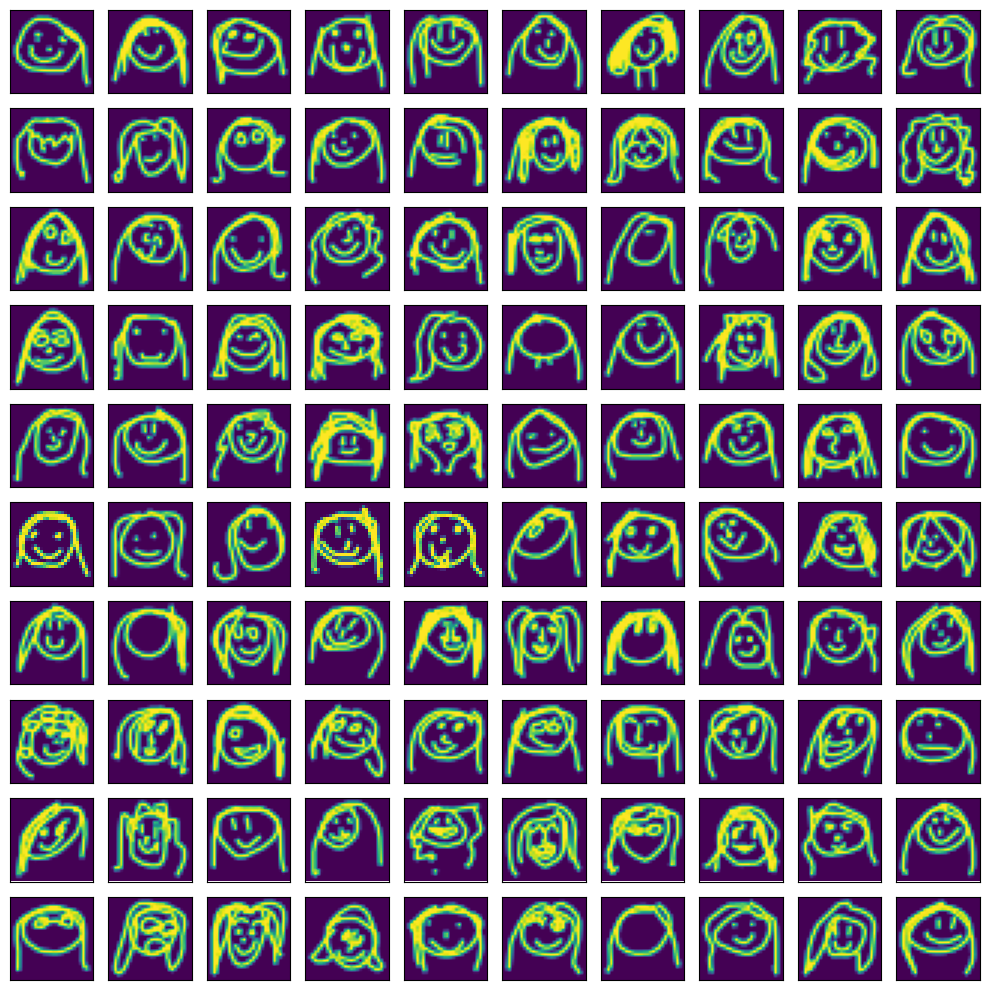

In [68]:
label = 6
print(f"Cluster {label}: {sum(labels == label)}")
plot_images(data[labels == label], 10, 10, n_plots=1)

Cluster 7: 241


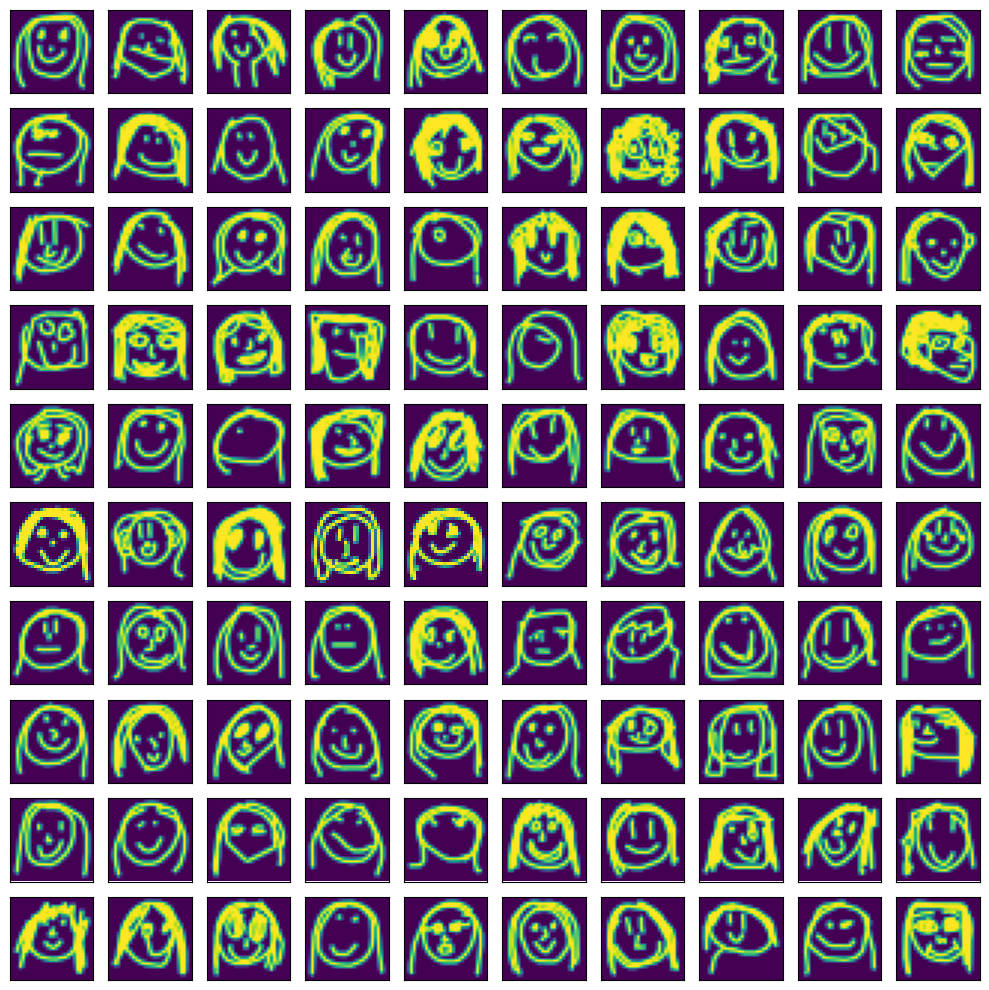

In [69]:
label = 7
print(f"Cluster {label}: {sum(labels == label)}")
plot_images(data[labels == label], 10, 10, n_plots=1)

Cluster 8: 3401


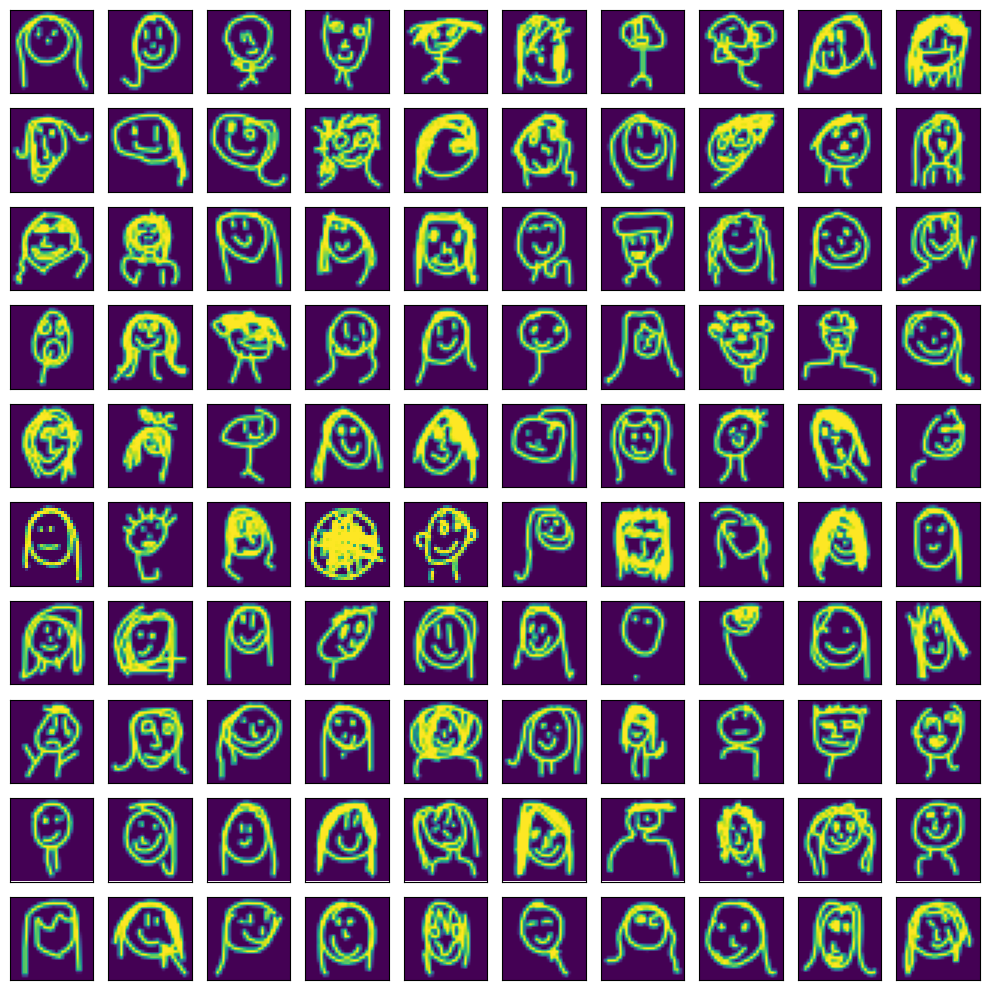

In [70]:
label = 8
print(f"Cluster {label}: {sum(labels == label)}")
plot_images(data[labels == label], 10, 10, n_plots=1)

In [71]:
sum(labels_to_keep)

140429

In [72]:
data = data[labels_to_keep]

In [73]:
del mapper, clusterable_embedding, labels, labels_to_keep, label, i

## Outliers

In [74]:
mapper = umap.UMAP(
    set_op_mix_ratio=0.25,
    verbose=True,
).fit(data)

UMAP(set_op_mix_ratio=0.25, verbose=True)
Fri Oct  6 22:44:46 2023 Construct fuzzy simplicial set
Fri Oct  6 22:44:46 2023 Finding Nearest Neighbors
Fri Oct  6 22:44:46 2023 Building RP forest with 24 trees
Fri Oct  6 22:44:54 2023 NN descent for 17 iterations
	 1  /  17
	 2  /  17
	 3  /  17
	 4  /  17
	 5  /  17
	 6  /  17
	Stopping threshold met -- exiting after 6 iterations
Fri Oct  6 22:45:04 2023 Finished Nearest Neighbor Search
Fri Oct  6 22:45:05 2023 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Fri Oct  6 22:45:37 2023 Finished embedding


<Axes: >

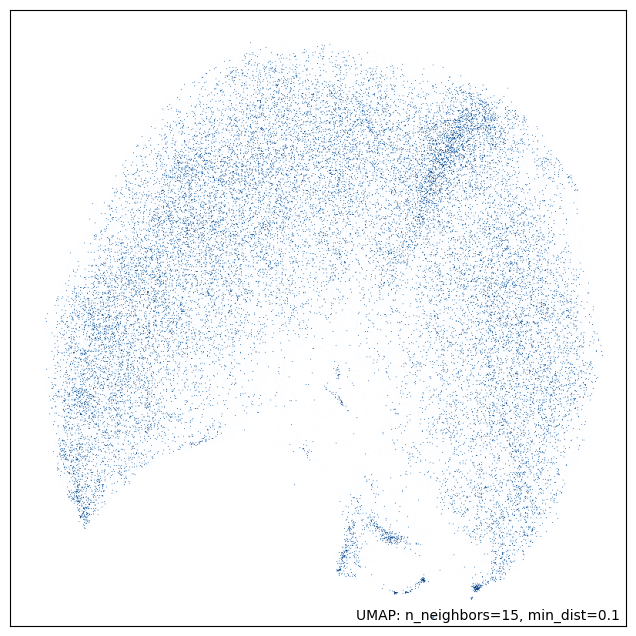

In [75]:
umap.plot.points(mapper)

In [76]:
outlier_scores = sklearn.neighbors.LocalOutlierFactor().fit_predict(mapper.embedding_)

In [77]:
sum(outlier_scores == -1)

175

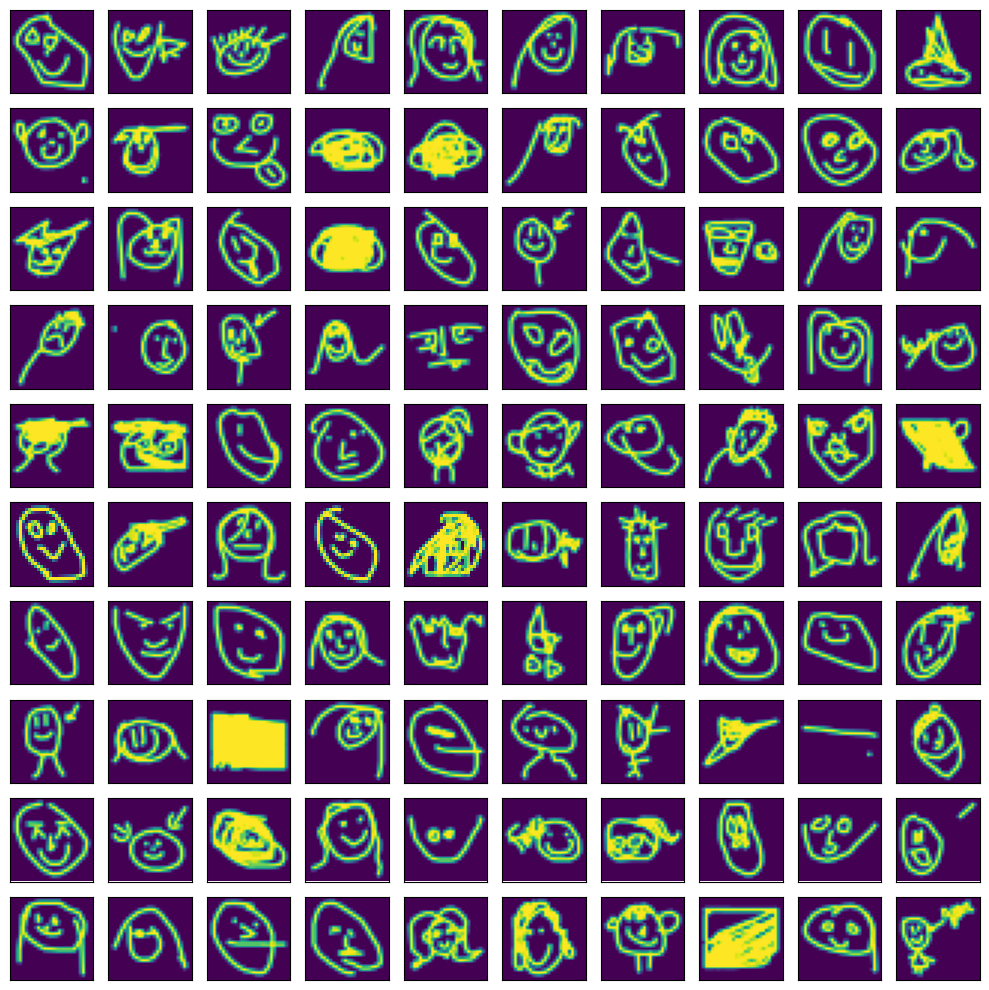

In [78]:
plot_images(data[outlier_scores == -1], 10, 10)

In [79]:
data = data[outlier_scores != -1]

In [80]:
del mapper, outlier_scores

## Clustering, again

In [81]:
mapper = umap.UMAP(
    n_neighbors=30,
    min_dist=0.0,
    verbose=True,
    n_epochs=500,
).fit(data)

UMAP(min_dist=0.0, n_epochs=500, n_neighbors=30, verbose=True)
Fri Oct  6 22:48:19 2023 Construct fuzzy simplicial set
Fri Oct  6 22:48:20 2023 Finding Nearest Neighbors
Fri Oct  6 22:48:20 2023 Building RP forest with 24 trees
Fri Oct  6 22:48:26 2023 NN descent for 17 iterations
	 1  /  17
	 2  /  17
	 3  /  17
	 4  /  17
	 5  /  17
	Stopping threshold met -- exiting after 5 iterations
Fri Oct  6 22:48:46 2023 Finished Nearest Neighbor Search
Fri Oct  6 22:48:48 2023 Construct embedding


Epochs completed:   0%|            0/500 [00:00]

	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
Fri Oct  6 22:51:04 2023 Finished embedding


<Axes: >

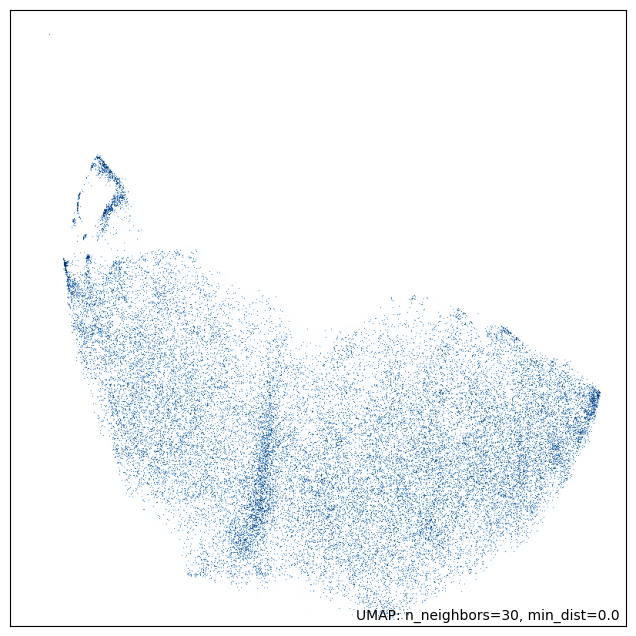

In [82]:
umap.plot.points(mapper)

In [83]:
clusterable_embedding = mapper.embedding_

In [84]:
labels = cluster.HDBSCAN(min_cluster_size=100).fit_predict(clusterable_embedding)

In [85]:
np.unique(labels)

array([-1,  0,  1,  2])

In [87]:
sum(labels == -1), sum(labels != -1)

(3032, 137222)

In [86]:
for i in np.unique(labels):
    print(f"Cluster {i}: {sum(labels == i)}")

Cluster -1: 3032
Cluster 0: 2726
Cluster 1: 134158
Cluster 2: 338


<Axes: >

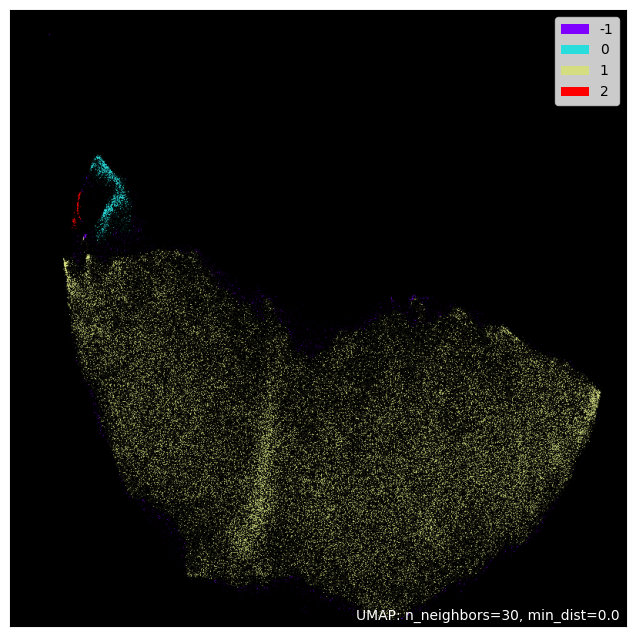

In [88]:
umap.plot.points(mapper, labels=labels, theme="fire")

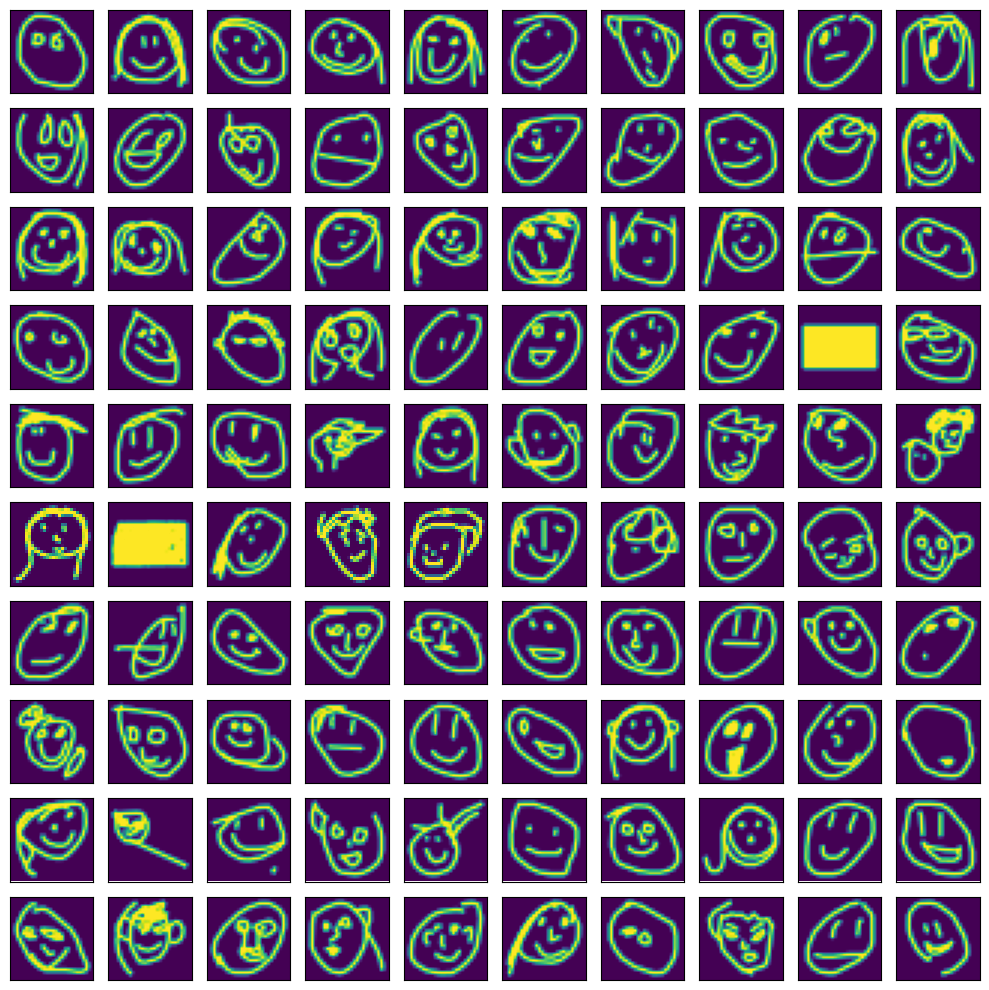

In [89]:
plot_images(data[labels == -1], 10, 10, n_plots=1)

In [90]:
labels_to_keep = labels == -1
sum(labels_to_keep)

3032

Cluster 0: 2726


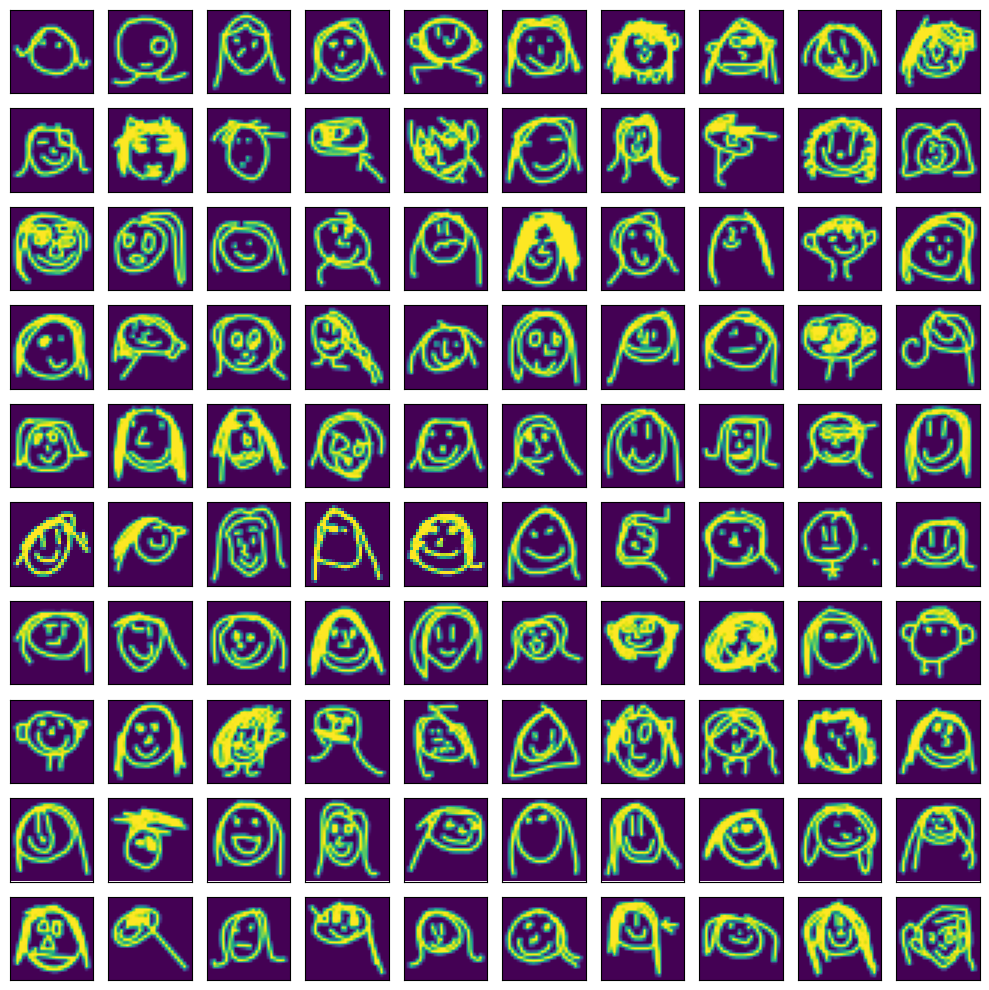

In [92]:
label = 0
print(f"Cluster {label}: {sum(labels == label)}")
plot_images(data[labels == label], 10, 10, n_plots=1)
# labels_to_keep = np.logical_or(labels_to_keep, labels == label)
# sum(labels_to_keep)

Cluster 1: 134158


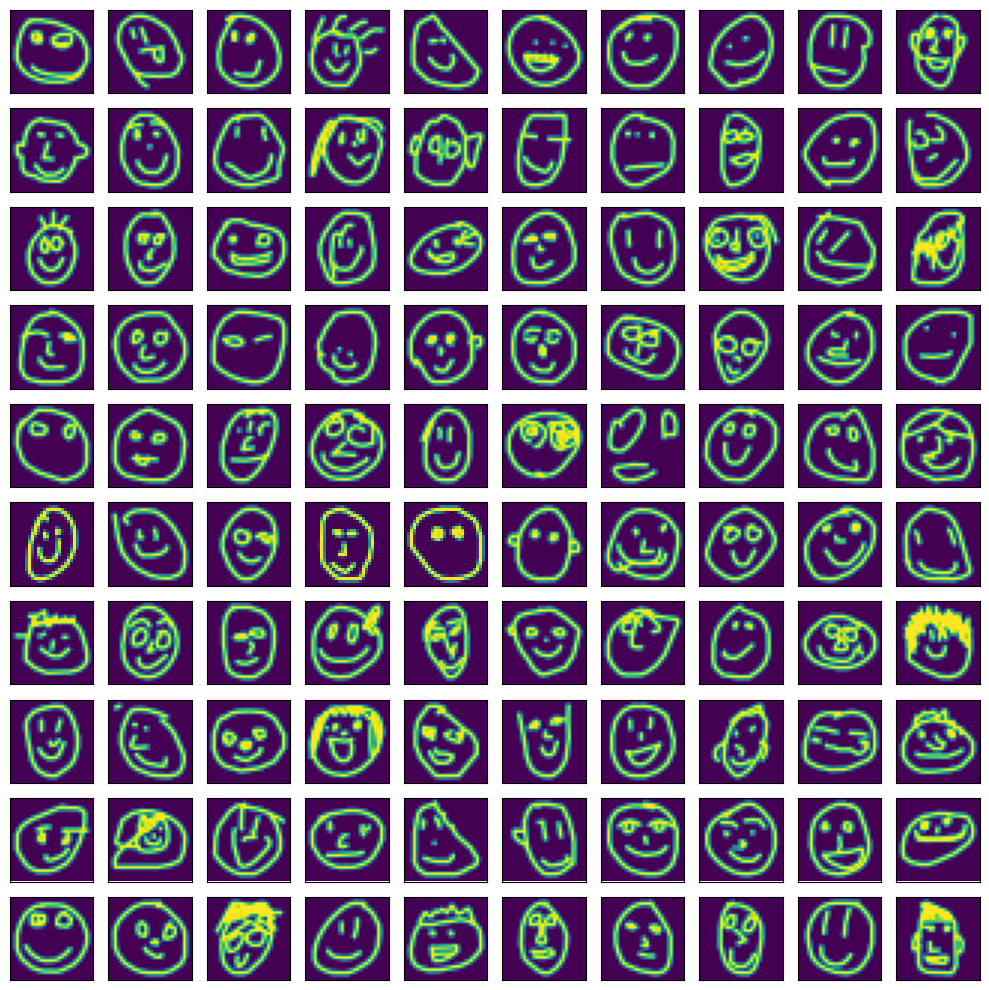

137190

In [94]:
label = 1
print(f"Cluster {label}: {sum(labels == label)}")
plot_images(data[labels == label], 10, 10, n_plots=1)
labels_to_keep = np.logical_or(labels_to_keep, labels == label)
sum(labels_to_keep)

Cluster 2: 338


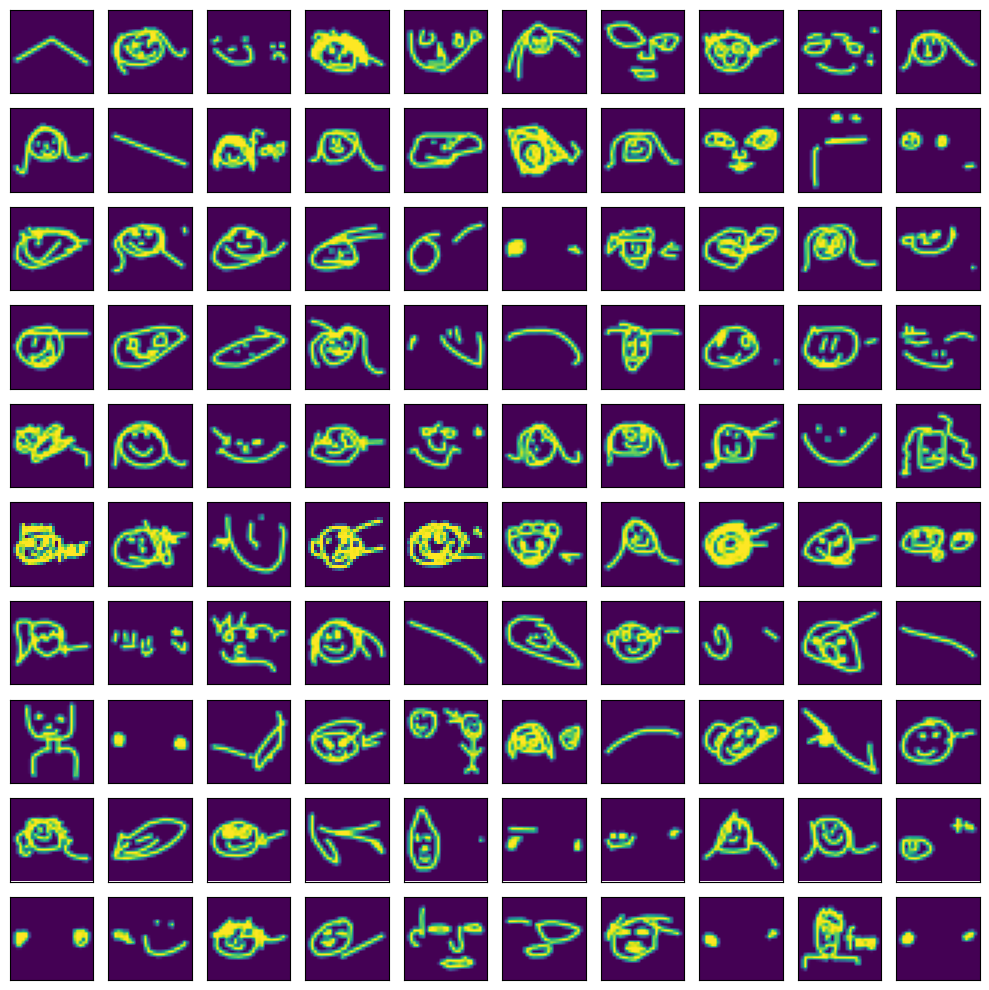

In [95]:
label = 2
print(f"Cluster {label}: {sum(labels == label)}")
plot_images(data[labels == label], 10, 10, n_plots=1)
# labels_to_keep = np.logical_or(labels_to_keep, labels == label)
# sum(labels_to_keep)

In [96]:
data = data[labels_to_keep]
len(data)

137190

In [105]:
dataset_face.data = data.reshape(-1, 28, 28)
dataset_face.targets = dataset_face.targets[:len(data)]
len(dataset_face)

137190

# Juntar datasets y analizar

In [106]:
dataset = dataset_smiley_face + dataset_face
dataset

Dataset QuickDraw
    Number of datapoints: 228162
    Root location: dataset

In [107]:
data = dataset.data.reshape(-1, 784)

# Outliers

In [108]:
mapper = umap.UMAP(
    set_op_mix_ratio=0.25,
    verbose=True,
).fit(data)

UMAP(set_op_mix_ratio=0.25, verbose=True)
Fri Oct  6 22:59:57 2023 Construct fuzzy simplicial set
Fri Oct  6 22:59:57 2023 Finding Nearest Neighbors
Fri Oct  6 22:59:57 2023 Building RP forest with 29 trees
Fri Oct  6 23:00:14 2023 NN descent for 18 iterations
	 1  /  18
	 2  /  18
	 3  /  18
	 4  /  18
	 5  /  18
	 6  /  18
	Stopping threshold met -- exiting after 6 iterations
Fri Oct  6 23:00:30 2023 Finished Nearest Neighbor Search
Fri Oct  6 23:00:31 2023 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Fri Oct  6 23:01:35 2023 Finished embedding


<Axes: >

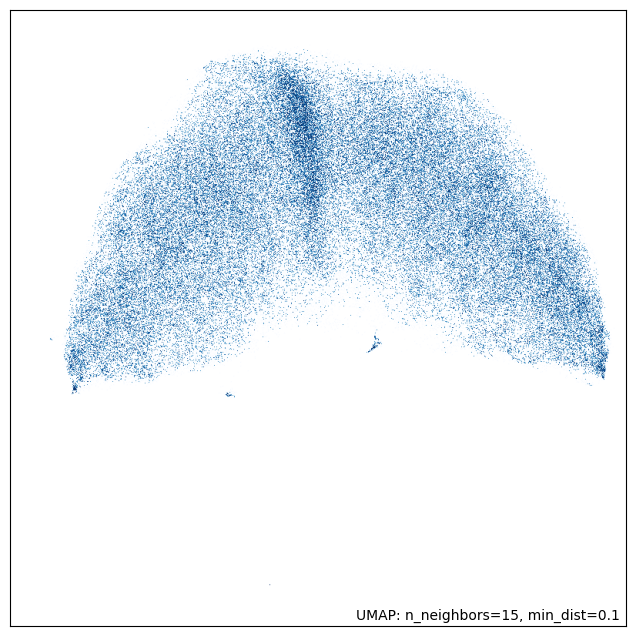

In [109]:
umap.plot.points(mapper)

In [110]:
outlier_scores = sklearn.neighbors.LocalOutlierFactor().fit_predict(mapper.embedding_)

In [111]:
sum(outlier_scores == -1)

151

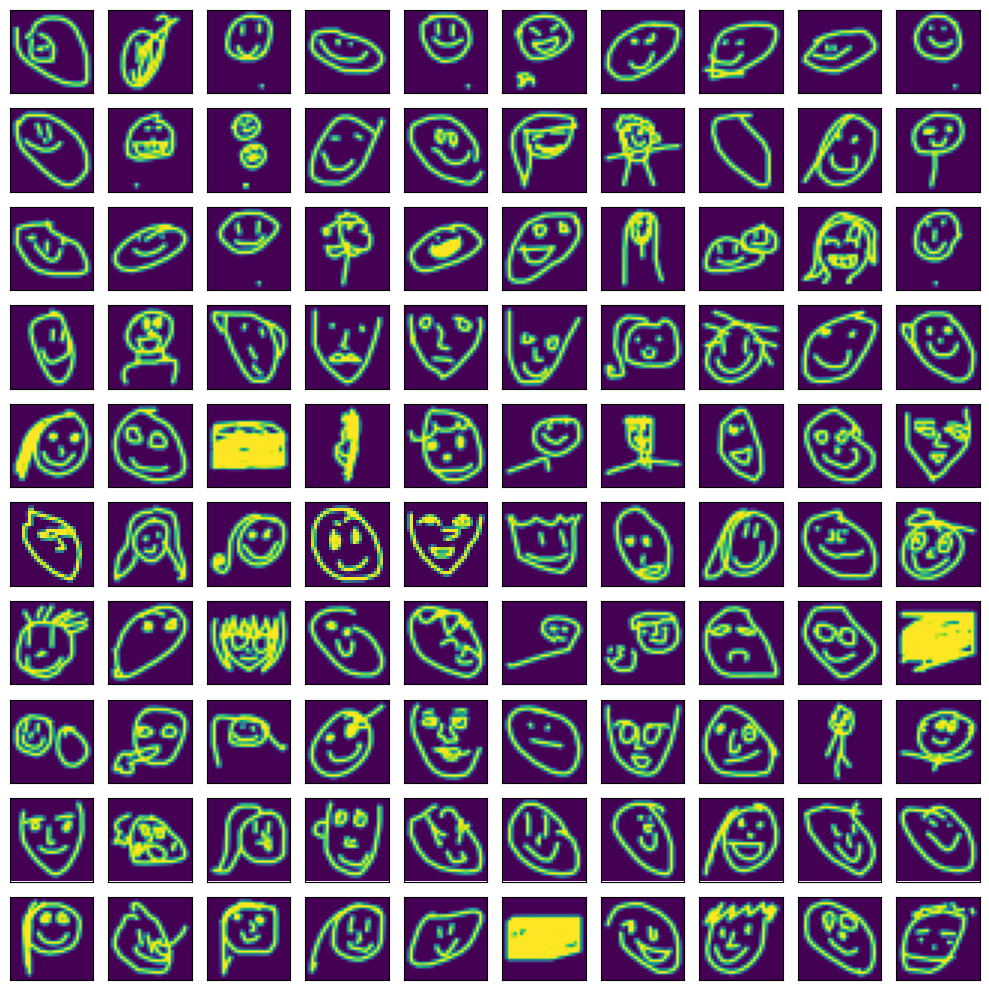

In [112]:
plot_images(data[outlier_scores == -1], 10, 10)

In [113]:
data = data[outlier_scores != -1]
len(data)

228011

In [114]:
del mapper, outlier_scores

# Clustering

In [115]:
mapper = umap.UMAP(
    n_neighbors=30,
    min_dist=0.0,
    verbose=True,
    # n_epochs=500,
).fit(data)

UMAP(min_dist=0.0, n_neighbors=30, verbose=True)
Fri Oct  6 23:03:17 2023 Construct fuzzy simplicial set
Fri Oct  6 23:03:17 2023 Finding Nearest Neighbors
Fri Oct  6 23:03:17 2023 Building RP forest with 29 trees
Fri Oct  6 23:03:31 2023 NN descent for 18 iterations
	 1  /  18
	 2  /  18
	 3  /  18
	 4  /  18
	 5  /  18
	Stopping threshold met -- exiting after 5 iterations
Fri Oct  6 23:04:01 2023 Finished Nearest Neighbor Search
Fri Oct  6 23:04:04 2023 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Fri Oct  6 23:06:33 2023 Finished embedding


<Axes: >

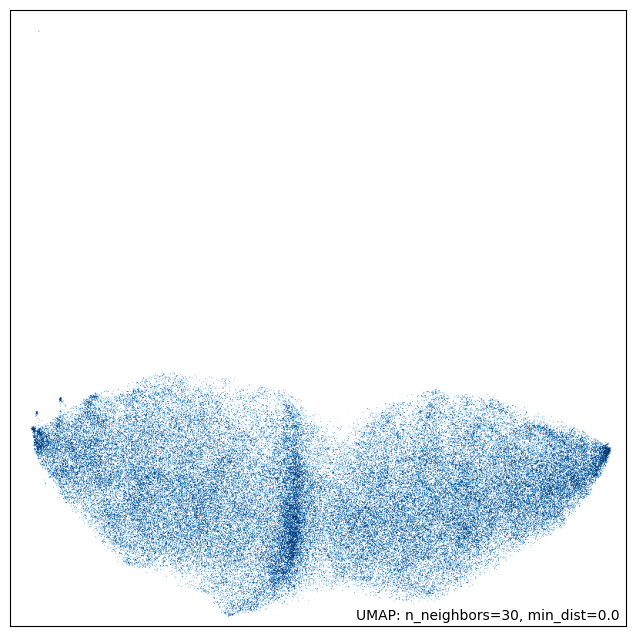

In [116]:
umap.plot.points(mapper)

In [117]:
clusterable_embedding = mapper.embedding_

In [121]:
labels = cluster.HDBSCAN().fit_predict(clusterable_embedding)

In [122]:
np.unique(labels)

array([0, 1])

In [123]:
for i in np.unique(labels):
    print(f"Cluster {i}: {sum(labels == i)}")

Cluster 0: 227989
Cluster 1: 22


<Axes: >

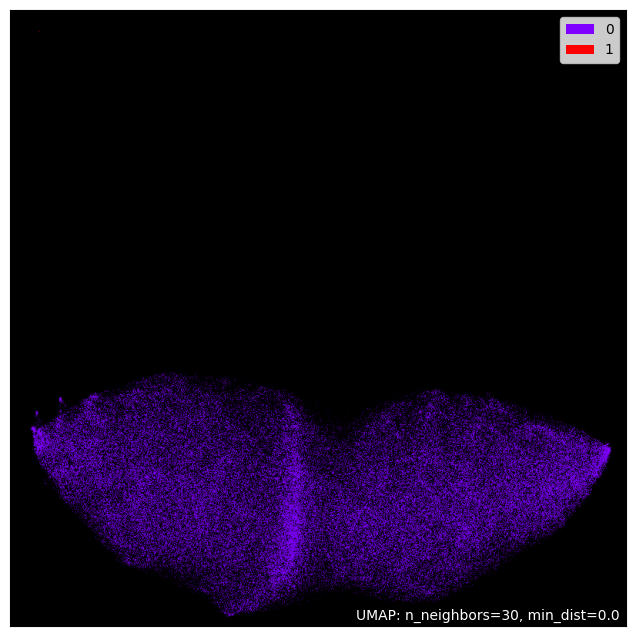

In [124]:
umap.plot.points(mapper, labels=labels, theme="fire")

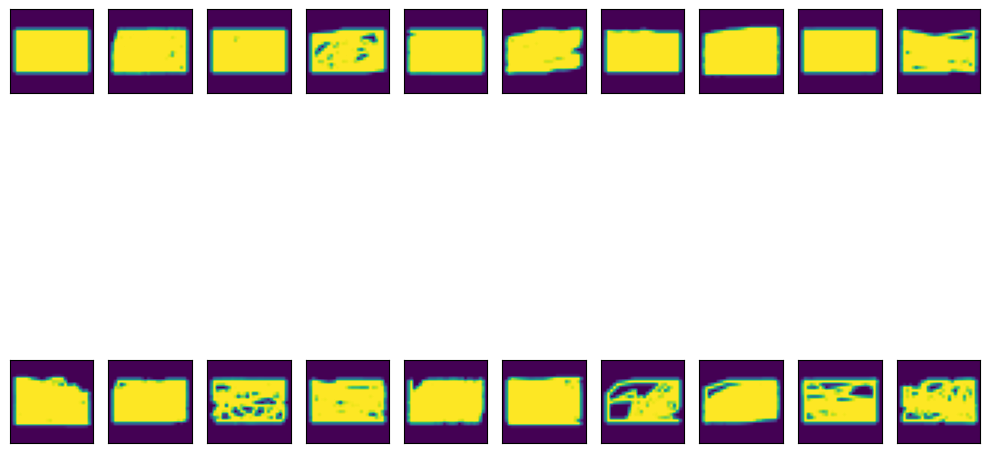

In [125]:
plot_images(data[labels == 1], 10, 2, n_plots=1)

In [126]:
data = data[labels == 0]
len(data)

227989

In [129]:
from pathlib import Path
DATASET_PATH = Path("dataset") / "cleaned"
DATASET_PATH.mkdir(exist_ok=True)

In [130]:
np.save(DATASET_PATH / "data.npy", data)